# Python Refresh - ABGDoyle et al 2018
## XGBoost and SHAP in Python (with basic processing via numpys/pandas)

original analysis in R: https://rpubs.com/aruberutou/803226
source data: https://github.com/doylelab/rxnpredict

...just playing with python here; refer to rpubs link for super rough analysis and next steps.

In [155]:
# load basic libraries

import numpy as np
import pandas as pd


In [260]:
# load xgboost and shap libraries

import xgboost as xgb
import shap
import matplotlib.pylab as pl



In [157]:
# load data from [1]
# must use github_raw (else error on read)

#plate1.1 - 1.4
plate1_1 = pd.read_csv("https://raw.githubusercontent.com/doylelab/rxnpredict/master/yield_data/plate1.1.csv")
plate1_2 = pd.read_csv("https://raw.githubusercontent.com/doylelab/rxnpredict/master/yield_data/plate1.2.csv")
plate1_3 = pd.read_csv("https://raw.githubusercontent.com/doylelab/rxnpredict/master/yield_data/plate1.3.csv")
plate1_4 = pd.read_csv("https://raw.githubusercontent.com/doylelab/rxnpredict/master/yield_data/plate1.4.csv")

#plate2.1 - 2.4
plate2_1 = pd.read_csv("https://raw.githubusercontent.com/doylelab/rxnpredict/master/yield_data/plate2.1.csv")
plate2_2 = pd.read_csv("https://raw.githubusercontent.com/doylelab/rxnpredict/master/yield_data/plate2.2.csv")
plate2_3 = pd.read_csv("https://raw.githubusercontent.com/doylelab/rxnpredict/master/yield_data/plate2.3.csv")
plate2_4 = pd.read_csv("https://raw.githubusercontent.com/doylelab/rxnpredict/master/yield_data/plate2.4.csv")

#plate3.1 - 3.4
plate3_1 = pd.read_csv("https://raw.githubusercontent.com/doylelab/rxnpredict/master/yield_data/plate3.1.csv")
plate3_2 = pd.read_csv("https://raw.githubusercontent.com/doylelab/rxnpredict/master/yield_data/plate3.2.csv")
plate3_3 = pd.read_csv("https://raw.githubusercontent.com/doylelab/rxnpredict/master/yield_data/plate3.3.csv")
plate3_4 = pd.read_csv("https://raw.githubusercontent.com/doylelab/rxnpredict/master/yield_data/plate3.4.csv")

In [160]:
# reshape and stich loaded data
# define function for basic operation

## test operation
raw_data = plate1_1.product_scaled[0:384] ## remember, python is zero-indexed
matrix_data = raw_data.values.reshape(24,16)
trans_data = matrix_data.transpose()
trans_data
## looks OK

# rewrite as function
def stitch_plate(plate_data):
    
    raw_data = plate1_1.product_scaled[0:384] ## remember, python is zero-indexed
    matrix_data = raw_data.values.reshape(24,16)
    trans_data = pd.DataFrame(matrix_data.transpose())
    
    return trans_data




In [161]:

#generate plate 1
#apply to subplates
plateData1_1 = stitch_plate(plate1_1)
plateData1_2 = stitch_plate(plate1_2)
plateData1_3 = stitch_plate(plate1_3)
plateData1_4 = stitch_plate(plate1_4)

#stitch subplates via concat (axis=1, for cbind; no axis for rbind)
plate1 = pd.concat(
    [pd.concat([plateData1_1,plateData1_2], axis = 1), 
     pd.concat([plateData1_3,plateData1_4], axis = 1)]
)

# check
plate1

,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
0,26.888615,20.671717,15.413893,3.606677,5.008761,57.375490,43.246874,33.753121,26.674899,5.980980,...,23.296079,1.297819,3.542496,64.608477,5.328990,25.142084,25.252703,2.038853,2.256360,71.265048
1,24.063224,37.065176,9.465696,35.078662,35.088724,22.611658,47.072017,43.984347,29.975430,50.582897,...,24.900114,28.350517,39.196864,63.854737,35.450257,40.991093,16.158511,28.760963,32.386358,64.028882
2,47.515821,40.108917,15.238758,43.318146,41.245607,28.751496,46.679233,45.013459,36.306361,45.080480,...,28.478495,40.181243,45.875638,76.336124,41.332487,45.960477,20.643574,44.560451,44.441973,74.639302
3,2.126831,1.571874,19.594289,0.000000,0.000000,26.988906,1.477833,1.141183,36.587989,0.000000,...,33.330652,0.000000,0.000000,73.139658,0.843583,1.429259,24.162563,0.380918,0.000000,76.160705
4,47.586354,13.579588,7.787908,29.298178,13.976947,20.857825,52.016631,45.262431,10.540820,42.119461,...,6.753074,40.451353,24.028197,4.497312,51.899805,39.815220,7.938108,44.687121,21.712229,5.908086
5,50.060026,19.584571,9.677592,37.565356,18.895249,20.734757,49.533289,48.877456,26.256884,49.111432,...,15.061369,42.273116,39.391349,40.876672,57.851453,43.942679,13.646554,52.788484,43.864265,52.866475
6,26.623393,5.831101,13.175217,0.960810,0.705195,30.871129,15.238016,5.162111,28.589648,0.705225,...,15.126717,0.910655,0.000000,40.316647,5.746329,3.976960,14.367370,1.112659,0.000000,56.034130
7,71.962560,34.705647,0.000000,59.019681,32.632341,0.000000,76.008061,70.200393,0.000000,70.862191,...,0.000000,62.163685,50.047476,0.000000,79.764305,67.277498,0.000000,67.020837,39.831557,0.000000
8,73.697234,10.657812,14.018641,70.968730,22.166448,20.360960,63.588682,15.417636,16.884861,66.449518,...,3.886636,66.886086,9.910073,24.273587,71.759511,6.575127,3.956886,72.466279,7.764964,12.721219
9,17.985710,14.747896,30.591262,35.139527,23.211569,38.916904,56.116780,18.974171,41.296984,65.939881,...,25.834572,76.834188,33.095159,42.644053,66.514880,8.742546,22.516172,55.089843,31.457764,41.677715


In [162]:
#generate plate 2
#apply to subplates
plateData2_1 = stitch_plate(plate2_1)
plateData2_2 = stitch_plate(plate2_2)
plateData2_3 = stitch_plate(plate2_3)
plateData2_4 = stitch_plate(plate2_4)

#stitch subplates via concat (axis=1, for cbind; no axis for rbind)
plate2 = pd.concat(
    [pd.concat([plateData2_1,plateData2_2], axis = 1), 
     pd.concat([plateData2_3,plateData2_4], axis = 1)]
)

# check
plate2

,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
0,26.888615,20.671717,15.413893,3.606677,5.008761,57.375490,43.246874,33.753121,26.674899,5.980980,...,23.296079,1.297819,3.542496,64.608477,5.328990,25.142084,25.252703,2.038853,2.256360,71.265048
1,24.063224,37.065176,9.465696,35.078662,35.088724,22.611658,47.072017,43.984347,29.975430,50.582897,...,24.900114,28.350517,39.196864,63.854737,35.450257,40.991093,16.158511,28.760963,32.386358,64.028882
2,47.515821,40.108917,15.238758,43.318146,41.245607,28.751496,46.679233,45.013459,36.306361,45.080480,...,28.478495,40.181243,45.875638,76.336124,41.332487,45.960477,20.643574,44.560451,44.441973,74.639302
3,2.126831,1.571874,19.594289,0.000000,0.000000,26.988906,1.477833,1.141183,36.587989,0.000000,...,33.330652,0.000000,0.000000,73.139658,0.843583,1.429259,24.162563,0.380918,0.000000,76.160705
4,47.586354,13.579588,7.787908,29.298178,13.976947,20.857825,52.016631,45.262431,10.540820,42.119461,...,6.753074,40.451353,24.028197,4.497312,51.899805,39.815220,7.938108,44.687121,21.712229,5.908086
5,50.060026,19.584571,9.677592,37.565356,18.895249,20.734757,49.533289,48.877456,26.256884,49.111432,...,15.061369,42.273116,39.391349,40.876672,57.851453,43.942679,13.646554,52.788484,43.864265,52.866475
6,26.623393,5.831101,13.175217,0.960810,0.705195,30.871129,15.238016,5.162111,28.589648,0.705225,...,15.126717,0.910655,0.000000,40.316647,5.746329,3.976960,14.367370,1.112659,0.000000,56.034130
7,71.962560,34.705647,0.000000,59.019681,32.632341,0.000000,76.008061,70.200393,0.000000,70.862191,...,0.000000,62.163685,50.047476,0.000000,79.764305,67.277498,0.000000,67.020837,39.831557,0.000000
8,73.697234,10.657812,14.018641,70.968730,22.166448,20.360960,63.588682,15.417636,16.884861,66.449518,...,3.886636,66.886086,9.910073,24.273587,71.759511,6.575127,3.956886,72.466279,7.764964,12.721219
9,17.985710,14.747896,30.591262,35.139527,23.211569,38.916904,56.116780,18.974171,41.296984,65.939881,...,25.834572,76.834188,33.095159,42.644053,66.514880,8.742546,22.516172,55.089843,31.457764,41.677715


In [163]:
#generate plate 3
#apply to subplates
plateData3_1 = stitch_plate(plate3_1)
plateData3_2 = stitch_plate(plate3_2)
plateData3_3 = stitch_plate(plate3_3)
plateData3_4 = stitch_plate(plate3_4)

#stitch subplates via concat (axis=1, for cbind; no axis for rbind)
plate3 = pd.concat(
    [pd.concat([plateData3_1,plateData3_2], axis = 1), 
     pd.concat([plateData3_3,plateData3_4], axis = 1)]
)

# check
plate3

,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
0,26.888615,20.671717,15.413893,3.606677,5.008761,57.375490,43.246874,33.753121,26.674899,5.980980,...,23.296079,1.297819,3.542496,64.608477,5.328990,25.142084,25.252703,2.038853,2.256360,71.265048
1,24.063224,37.065176,9.465696,35.078662,35.088724,22.611658,47.072017,43.984347,29.975430,50.582897,...,24.900114,28.350517,39.196864,63.854737,35.450257,40.991093,16.158511,28.760963,32.386358,64.028882
2,47.515821,40.108917,15.238758,43.318146,41.245607,28.751496,46.679233,45.013459,36.306361,45.080480,...,28.478495,40.181243,45.875638,76.336124,41.332487,45.960477,20.643574,44.560451,44.441973,74.639302
3,2.126831,1.571874,19.594289,0.000000,0.000000,26.988906,1.477833,1.141183,36.587989,0.000000,...,33.330652,0.000000,0.000000,73.139658,0.843583,1.429259,24.162563,0.380918,0.000000,76.160705
4,47.586354,13.579588,7.787908,29.298178,13.976947,20.857825,52.016631,45.262431,10.540820,42.119461,...,6.753074,40.451353,24.028197,4.497312,51.899805,39.815220,7.938108,44.687121,21.712229,5.908086
5,50.060026,19.584571,9.677592,37.565356,18.895249,20.734757,49.533289,48.877456,26.256884,49.111432,...,15.061369,42.273116,39.391349,40.876672,57.851453,43.942679,13.646554,52.788484,43.864265,52.866475
6,26.623393,5.831101,13.175217,0.960810,0.705195,30.871129,15.238016,5.162111,28.589648,0.705225,...,15.126717,0.910655,0.000000,40.316647,5.746329,3.976960,14.367370,1.112659,0.000000,56.034130
7,71.962560,34.705647,0.000000,59.019681,32.632341,0.000000,76.008061,70.200393,0.000000,70.862191,...,0.000000,62.163685,50.047476,0.000000,79.764305,67.277498,0.000000,67.020837,39.831557,0.000000
8,73.697234,10.657812,14.018641,70.968730,22.166448,20.360960,63.588682,15.417636,16.884861,66.449518,...,3.886636,66.886086,9.910073,24.273587,71.759511,6.575127,3.956886,72.466279,7.764964,12.721219
9,17.985710,14.747896,30.591262,35.139527,23.211569,38.916904,56.116780,18.974171,41.296984,65.939881,...,25.834572,76.834188,33.095159,42.644053,66.514880,8.742546,22.516172,55.089843,31.457764,41.677715


In [164]:
# merge plates

all_plates = pd.concat([plate1, plate2, plate3]).reset_index(drop=False) ## merge and reset indices
all_plates.drop("index", axis=1, inplace=True) ## drop index column
all_plates

,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
0,26.888615,20.671717,15.413893,3.606677,5.008761,57.375490,43.246874,33.753121,26.674899,5.980980,...,23.296079,1.297819,3.542496,64.608477,5.328990,25.142084,25.252703,2.038853,2.256360,71.265048
1,24.063224,37.065176,9.465696,35.078662,35.088724,22.611658,47.072017,43.984347,29.975430,50.582897,...,24.900114,28.350517,39.196864,63.854737,35.450257,40.991093,16.158511,28.760963,32.386358,64.028882
2,47.515821,40.108917,15.238758,43.318146,41.245607,28.751496,46.679233,45.013459,36.306361,45.080480,...,28.478495,40.181243,45.875638,76.336124,41.332487,45.960477,20.643574,44.560451,44.441973,74.639302
3,2.126831,1.571874,19.594289,0.000000,0.000000,26.988906,1.477833,1.141183,36.587989,0.000000,...,33.330652,0.000000,0.000000,73.139658,0.843583,1.429259,24.162563,0.380918,0.000000,76.160705
4,47.586354,13.579588,7.787908,29.298178,13.976947,20.857825,52.016631,45.262431,10.540820,42.119461,...,6.753074,40.451353,24.028197,4.497312,51.899805,39.815220,7.938108,44.687121,21.712229,5.908086
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91,21.327764,2.475058,0.456472,51.102490,0.948129,0.940122,72.106406,2.663355,0.655701,66.207936,...,0.000000,66.372742,0.297247,0.345789,76.192934,1.705289,0.000000,66.283264,0.230274,0.316193
92,49.059786,6.119058,3.867386,3.963450,16.649665,14.904507,60.169154,16.048548,33.629056,6.110692,...,15.166649,2.534585,43.424679,40.979492,17.918285,12.295943,15.821794,6.141106,47.713002,40.294189
93,13.607072,5.449924,7.024622,31.930310,19.999826,19.596159,76.239809,21.976633,41.489808,67.818501,...,40.374031,47.174418,45.275010,43.261943,57.183596,16.857023,40.139694,54.563582,54.769859,45.400159
94,75.739228,7.802080,2.846164,48.708232,4.992379,4.179760,73.245932,7.641918,2.599454,72.630649,...,0.000000,52.435894,0.858975,1.497955,68.688946,3.595206,0.576933,63.224692,0.737631,0.778234


In [195]:
# quality control
# cols to drop
cols_to_drop = [15,31,47]
# rows to drop
rows_to_drop = [0,4,8,12,19,23,27,31]


# 
all_plates_nocontrols = all_plates.reset_index(drop=False)
all_plates_nocontrols.drop(all_plates_nocontrols.columns[cols_to_drop], axis=1, inplace=True)
all_plates_nocontrols.drop(all_plates_nocontrols.index[rows_to_drop], inplace=True)
yield_data = all_plates_nocontrols.values.flatten(order='F')

yield_data

array([ 1.        ,  2.        ,  3.        , ..., 45.40015878,
        0.77823411, 65.05218409])

In [196]:
yield_data.shape

(3784,)

In [169]:
# grab descriptor data

output_table = pd.read_csv("https://github.com/doylelab/rxnpredict/blob/master/R/output_table.csv?raw=true")
output_table

,additive_*C3_NMR_shift,additive_*C3_electrostatic_charge,additive_*C4_NMR_shift,additive_*C4_electrostatic_charge,additive_*C5_NMR_shift,additive_*C5_electrostatic_charge,additive_*N1_electrostatic_charge,additive_*O1_electrostatic_charge,additive_E_HOMO,additive_E_LUMO,...,ligand_V5_intensity,ligand_V6_frequency,ligand_V6_intensity,ligand_V7_frequency,ligand_V7_intensity,ligand_V8_frequency,ligand_V8_intensity,ligand_V9_frequency,ligand_V9_intensity,ligand_dipole_moment
0,143.12,0.223,93.06,-0.447,162.34,0.292,-0.334,-0.057,-0.2317,-0.0487,...,0.955,1640.307,4.414,3026.561,16.577,3043.097,18.145,3064.344,38.210,1.212924
1,143.12,0.223,93.06,-0.447,162.34,0.292,-0.334,-0.057,-0.2317,-0.0487,...,0.955,1640.307,4.414,3026.561,16.577,3043.097,18.145,3064.344,38.210,1.212924
2,143.12,0.223,93.06,-0.447,162.34,0.292,-0.334,-0.057,-0.2317,-0.0487,...,0.955,1640.307,4.414,3026.561,16.577,3043.097,18.145,3064.344,38.210,1.212924
3,143.12,0.223,93.06,-0.447,162.34,0.292,-0.334,-0.057,-0.2317,-0.0487,...,0.955,1640.307,4.414,3026.561,16.577,3043.097,18.145,3064.344,38.210,1.212924
4,143.12,0.223,93.06,-0.447,162.34,0.292,-0.334,-0.057,-0.2317,-0.0487,...,0.955,1640.307,4.414,3026.561,16.577,3043.097,18.145,3064.344,38.210,1.212924
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3955,152.98,0.429,98.09,-0.589,159.31,0.387,-0.350,-0.068,-0.2337,-0.0696,...,33.970,1631.618,37.445,3025.675,16.220,1054.500,1.432,3041.406,35.621,3.735286
3956,152.98,0.429,98.09,-0.589,159.31,0.387,-0.350,-0.068,-0.2337,-0.0696,...,33.970,1631.618,37.445,3025.675,16.220,1054.500,1.432,3041.406,35.621,3.735286
3957,152.98,0.429,98.09,-0.589,159.31,0.387,-0.350,-0.068,-0.2337,-0.0696,...,33.970,1631.618,37.445,3025.675,16.220,1054.500,1.432,3041.406,35.621,3.735286
3958,152.98,0.429,98.09,-0.589,159.31,0.387,-0.350,-0.068,-0.2337,-0.0696,...,33.970,1631.618,37.445,3025.675,16.220,1054.500,1.432,3041.406,35.621,3.735286


In [214]:
## yield numbers not adding up (flatten drops na values??)
## activate cheat: load from r output

yield_label = pd.read_csv("~/RStudioi/ABGDoyle/yield_label.csv")
yield_label.drop(yield_label.columns[[0]], axis = 1, inplace = True)
yield_label


,yield_data,yield=0%,yield<=5%,yield<=10%
0,10.657812,1.0,1.0,1.0
1,14.747896,1.0,1.0,1.0
2,18.278686,1.0,1.0,1.0
3,2.475058,1.0,0.0,0.0
4,6.119058,1.0,1.0,0.0
...,...,...,...,...
3955,57.426670,1.0,1.0,1.0
3956,86.233157,1.0,1.0,1.0
3957,1.440081,1.0,0.0,0.0
3958,43.538365,1.0,1.0,1.0


In [216]:
## merge yield and descriptor data

output_table = pd.concat([yield_label,output_table], axis = 1)
output_table

,yield_data,yield=0%,yield<=5%,yield<=10%,additive_*C3_NMR_shift,additive_*C3_electrostatic_charge,additive_*C4_NMR_shift,additive_*C4_electrostatic_charge,additive_*C5_NMR_shift,additive_*C5_electrostatic_charge,...,ligand_V5_intensity,ligand_V6_frequency,ligand_V6_intensity,ligand_V7_frequency,ligand_V7_intensity,ligand_V8_frequency,ligand_V8_intensity,ligand_V9_frequency,ligand_V9_intensity,ligand_dipole_moment
0,10.657812,1.0,1.0,1.0,143.12,0.223,93.06,-0.447,162.34,0.292,...,0.955,1640.307,4.414,3026.561,16.577,3043.097,18.145,3064.344,38.210,1.212924
1,14.747896,1.0,1.0,1.0,143.12,0.223,93.06,-0.447,162.34,0.292,...,0.955,1640.307,4.414,3026.561,16.577,3043.097,18.145,3064.344,38.210,1.212924
2,18.278686,1.0,1.0,1.0,143.12,0.223,93.06,-0.447,162.34,0.292,...,0.955,1640.307,4.414,3026.561,16.577,3043.097,18.145,3064.344,38.210,1.212924
3,2.475058,1.0,0.0,0.0,143.12,0.223,93.06,-0.447,162.34,0.292,...,0.955,1640.307,4.414,3026.561,16.577,3043.097,18.145,3064.344,38.210,1.212924
4,6.119058,1.0,1.0,0.0,143.12,0.223,93.06,-0.447,162.34,0.292,...,0.955,1640.307,4.414,3026.561,16.577,3043.097,18.145,3064.344,38.210,1.212924
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3955,57.426670,1.0,1.0,1.0,152.98,0.429,98.09,-0.589,159.31,0.387,...,33.970,1631.618,37.445,3025.675,16.220,1054.500,1.432,3041.406,35.621,3.735286
3956,86.233157,1.0,1.0,1.0,152.98,0.429,98.09,-0.589,159.31,0.387,...,33.970,1631.618,37.445,3025.675,16.220,1054.500,1.432,3041.406,35.621,3.735286
3957,1.440081,1.0,0.0,0.0,152.98,0.429,98.09,-0.589,159.31,0.387,...,33.970,1631.618,37.445,3025.675,16.220,1054.500,1.432,3041.406,35.621,3.735286
3958,43.538365,1.0,1.0,1.0,152.98,0.429,98.09,-0.589,159.31,0.387,...,33.970,1631.618,37.445,3025.675,16.220,1054.500,1.432,3041.406,35.621,3.735286


In [ ]:
## generate data sets for training and test

# Set sample ratio for 70/30 split
sample_ratio = 0.7

# Let's go about it 
output_table.sample(frac=sample_ratio, random_state=1011, axis=0)

# Split scaled into training and test set (70/30)
size = round(sample_ratio*output_table.shape[0])
training = sample(output_table.shape[0], size=size, replace=FALSE)
training.scaled <- output.scaled[training,]
test.scaled <- output.scaled[-training,]

# Split nominal into training and test set (70/30)
set.seed(1084)
size <- round(sample.ratio*nrow(output.nominal))
training <- sample(nrow(output.nominal), size=size, replace=FALSE)
training.nominal <- output.nominal[training,]
test.nominal <- output.nominal[-training,]

In [220]:
## generate data sets for training and test
# generate mask for 70/30 split
msk = np.random.rand(len(output_table)) < 0.7
# create split data sets
train = output_table[msk]
test = output_table[~msk]

In [253]:
## xgboost

# preformat data (otherwise cannot be used directly by DMatrix)
y_train = (train.iloc[:,3]==1)
y_test = (test.iloc[:,3]==1)

X_test = test.drop(test.columns[[0,1,2,3]], axis = 1)
X_train = train.drop(train.columns[[0,1,2,3]], axis = 1)

# generate input data
d_train = xgb.DMatrix(X_train, label=y_train)
d_test = xgb.DMatrix(X_test, label=y_test)

In [254]:
## set xgboost parameters

params = {
    "objective": "binary:logistic",  ## specifies additive logistic repression
    "base_score": .95, ## weight of evidence per branch (quasi-confidence); increase from .5 default to .95
    "eval_metric": "error@.95", ## weight of evidence for entire tree; increase from .5 default to .95
    "max_depth": 12, 
    "colsample_bytree": .5, 
    "num_parallel_tree": 6, 
    "eta": .003, 
    "max_bin": 512, 
    "predictor": "cpu_predictor", 
    "booster": "gbtree", 
    "eval_metric": "aucpr", 
    "eval_metric": "auc", 
    "eval_metric": "ndcg", 
    "eval_metric": "map", 
    "eval_metric": "logloss"
}

In [257]:
## run xgboost model
## this model's a bit different from the one generated in R ...
## ... can't figure out how to hack the evaluation schema in python, so meh. しがたないっすね。

model = xgb.train(params, 
                      d_train, 
                      5000, 
                      evals = [(d_test, "test")], 
                      verbose_eval=100, 
                      early_stopping_rounds=20)


[0]	test-logloss:0.89285
[100]	test-logloss:0.50656
[200]	test-logloss:0.38064
[300]	test-logloss:0.31292
[400]	test-logloss:0.27009
[500]	test-logloss:0.24213
[600]	test-logloss:0.22216
[700]	test-logloss:0.20732
[800]	test-logloss:0.19580
[900]	test-logloss:0.18709
[1000]	test-logloss:0.18061
[1100]	test-logloss:0.17569
[1200]	test-logloss:0.17188
[1300]	test-logloss:0.16909
[1400]	test-logloss:0.16687
[1500]	test-logloss:0.16509
[1600]	test-logloss:0.16386
[1700]	test-logloss:0.16280
[1800]	test-logloss:0.16185
[1900]	test-logloss:0.16107
[2000]	test-logloss:0.16042
[2100]	test-logloss:0.15979
[2200]	test-logloss:0.15923
[2300]	test-logloss:0.15865
[2400]	test-logloss:0.15804
[2500]	test-logloss:0.15753
[2600]	test-logloss:0.15731
[2700]	test-logloss:0.15714
[2800]	test-logloss:0.15700
[2900]	test-logloss:0.15671
[3000]	test-logloss:0.15647
[3100]	test-logloss:0.15628
[3200]	test-logloss:0.15602
[3300]	test-logloss:0.15592
[3400]	test-logloss:0.15570
[3500]	test-logloss:0.15558
[360

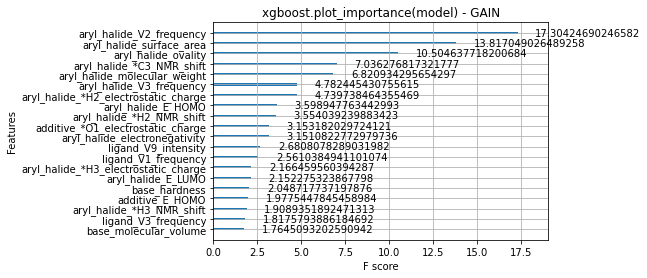

In [275]:
# Some importance plots...
# First, in terms of "Gain"
# "Gain" is the average gain of splits which use the feature

xgb.plot_importance(model, max_num_features=20, importance_type='gain')
pl.title("xgboost.plot_importance(model) - GAIN")
pl.show()

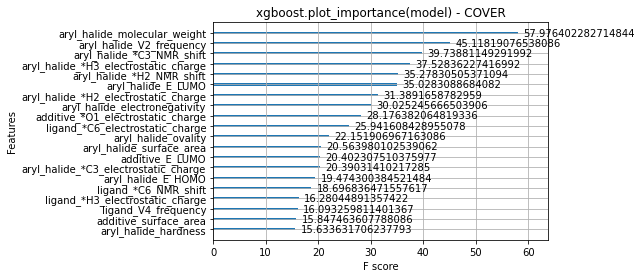

In [276]:
# Next, importance in terms of "Cover"
# "Cover" is the average coverage of splits which use the feature ...
# ... where coverage is defined as the number of samples affected by the split

xgb.plot_importance(model, max_num_features=20, importance_type='cover')
pl.title("xgboost.plot_importance(model) - COVER")
pl.show()

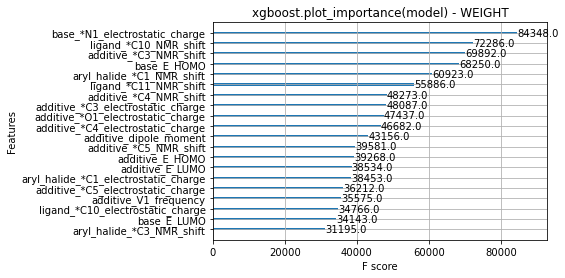

In [277]:
# Next, importance in terms of "WEIGHT"
# ”Weight” is the number of times a feature appears in a tree

xgb.plot_importance(model, max_num_features=20, importance_type='weight')
pl.title("xgboost.plot_importance(model) - WEIGHT")
pl.show()

In [264]:
# generate SHAP model using training data
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_train)

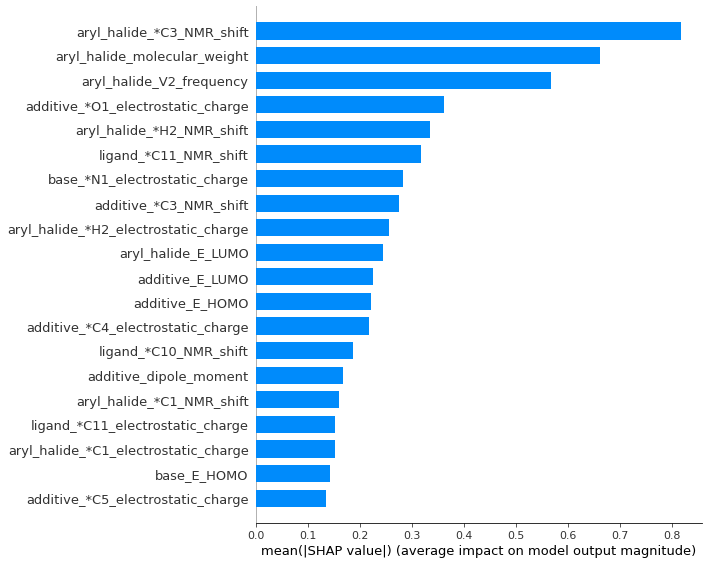

In [269]:
# mean importance chart for SHAP
# displays the mean absolute value of each feature wrt SHAP

shap.summary_plot(shap_values, X_train, plot_type="bar")

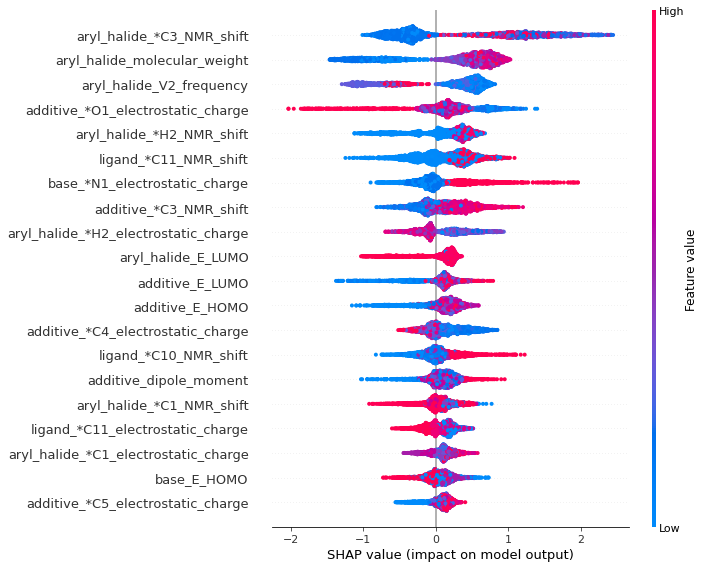

In [270]:
# SHAP summary plot
# SHAP imputes effect estimations on a case-wise basis
# Here, the effect for each feature is plotted and colored against its nominal value

shap.summary_plot(shap_values, X_train)

In [272]:
# generate SHAP force 
# Interactive chart allowing the effect of each feature to be explored across the dataset -- very cool
# Supervised clustering is implemented, whereby groups are organized according to effect-based similarity

shap.initjs()
shap.force_plot(explainer.expected_value, shap_values, X_train)